Andrew Berger said that apart from Voights creek, there are other ponds/hatcheries from which hatchery fish have been released into the puyallup river. I have queried rmis data based on this new information and have processed that data in r. I am reading the new data file and merging it with the new puyallup data (with air temperature)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

from sys import platform
if platform == "linux" or platform == "linux2":
    data_string = "/home/maria/Documents/data/pied_piper/puyallup/"
    output_string = "/home/maria/Documents/output/pied_piper/puyallup/"

elif platform == "win32"or platform == "win64":
    data_string = "C:/Users/maria/OneDrive/Documents/data/pied_piper/puyallup/"
    output_string = "C:/Users/maria/OneDrive/Documents/output/pied_piper/puyallup/"

In [9]:
df_puyallup_chinook = pd.read_csv(data_string + 'chinook_subset_rmis.csv')
df_puyallup_chinook['total_chinook0'] = df_puyallup_chinook['total']
df_puyallup_chinook['untagged_unclipped_chinook0'] = df_puyallup_chinook['untagged_unclipped']
df_puyallup_chinook['prop_unmarked_chinook0'] = df_puyallup_chinook['prop_unmarked']
df_puyallup_chinook = df_puyallup_chinook[['date','total_chinook0', 'untagged_unclipped_chinook0', 'prop_unmarked_chinook0']]
df_puyallup_chinook

,date,total_chinook0,untagged_unclipped_chinook0,prop_unmarked_chinook0
0,2004-05-26,1646664,18071,0.010974
1,2004-06-02,103200,546,0.005291
2,2005-05-25,902950,0,0.000000
3,2005-06-01,100400,0,0.000000
4,2006-05-30,1404632,10698,0.007616
5,2006-06-02,254585,2266,0.008901
6,2007-05-29,82927,2012,0.024262
7,2007-06-05,1797777,8465,0.004709
8,2008-05-22,96500,0,0.000000
9,2008-06-13,1695500,6408,0.003779


In [10]:
df_puyallup_coho = pd.read_csv(data_string + 'coho_subset_rmis.csv')
df_puyallup_coho['total_coho1'] = df_puyallup_coho['total']
df_puyallup_coho['untagged_unclipped_coho1'] = df_puyallup_coho['untagged_unclipped']
df_puyallup_coho['prop_unmarked_coho1'] = df_puyallup_coho['prop_unmarked']
df_puyallup_coho = df_puyallup_coho[['date','total_coho1','untagged_unclipped_coho1','prop_unmarked_coho1']]
df_puyallup_coho

,date,total_coho1,untagged_unclipped_coho1,prop_unmarked_coho1
0,2004-04-15,848000,11158,0.013158
1,2004-04-26,177000,1132,0.006395
2,2005-03-14,111820,0,0.000000
3,2005-04-20,915000,495,0.000541
4,2006-04-18,879000,10366,0.011793
5,2006-05-30,102553,1,0.000010
6,2007-04-30,672300,3160,0.004700
7,2007-05-08,80200,0,0.000000
8,2008-04-25,799100,5476,0.006853
9,2009-01-09,505100,2496,0.004942


In [11]:
puyallup_catch = pd.read_csv(data_string + "puyallup_final.csv")
puyallup_catch

,Unnamed: 0,...1,Date,flow,secchi_depth,In_day,In_night,In,chinook0_wild_num_day,chinook0_wild_perhour_day,...,lunar_phase_day,lunar_phase_night,flow_diff_day,flow_diff_night,photo_diff_day,photo_diff_night,temp_diff_day,temp_diff_night,resid_day,resid_night
0,1,0,2004-02-29,1050.000000,150.0,8.50,13.75,22.25,0.0,0.000000,...,0.581360,0.581360,NaN,NaN,NaN,NaN,NaN,NaN,-5.020587,-5.020587
1,2,1,2004-03-01,982.000000,150.0,10.75,15.25,26.00,0.0,0.000000,...,0.672588,0.672588,-68.000000,-68.000000,0.066667,0.066667,0.0,0.0,-5.107222,-5.107222
2,3,2,2004-03-02,923.000000,150.0,10.25,13.75,24.00,1.0,0.097561,...,0.758745,0.758745,-59.000000,-59.000000,0.050000,0.050000,0.0,0.0,-5.172199,-5.172199
3,4,3,2004-03-03,955.000000,150.0,10.25,14.25,24.50,0.0,0.000000,...,0.836781,0.836781,32.000000,32.000000,0.066667,0.066667,-1.0,-1.0,-6.258834,-6.258834
4,5,4,2004-03-04,1300.000000,150.0,9.25,15.00,24.25,0.0,0.000000,...,0.903295,0.903295,345.000000,345.000000,0.050000,0.050000,-0.9,-0.9,-7.223810,-7.223810
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6368,6369,6368,2021-08-06,1065.343750,15.0,NaN,NaN,NaN,NaN,NaN,...,0.068349,0.068349,-15.052083,-15.052083,-0.050000,-0.050000,-2.7,-2.7,3.636140,3.636140
6369,6370,6369,2021-08-07,1294.895833,15.0,NaN,NaN,NaN,NaN,NaN,...,0.027146,0.027146,229.552083,229.552083,-0.050000,-0.050000,-1.1,-1.1,2.601116,2.601116
6370,6371,6370,2021-08-08,1296.593750,30.0,NaN,NaN,NaN,NaN,NaN,...,0.004917,0.004917,1.697917,1.697917,-0.050000,-0.050000,-3.5,-3.5,-0.833908,-0.833908
6371,6372,6371,2021-08-09,875.979167,15.0,NaN,NaN,NaN,NaN,NaN,...,0.003901,0.003901,-420.614583,-420.614583,-0.033333,-0.033333,3.8,3.8,3.009410,3.009410


In [13]:
puyallup_catch['Date'] = pd.to_datetime(puyallup_catch['Date'])
df_puyallup_chinook['date'] = pd.to_datetime(df_puyallup_chinook['date'])
df_puyallup_coho['date'] = pd.to_datetime(df_puyallup_coho['date'])
df_merged = puyallup_catch.merge(df_puyallup_chinook, left_on = 'Date', right_on = 'date', how = 'left')
df_merged = df_merged.merge(df_puyallup_coho, left_on = 'Date', right_on = 'date', how = 'left')
df_merged.head()

,Unnamed: 0,...1,Date,flow,secchi_depth,In_day,In_night,In,chinook0_wild_num_day,chinook0_wild_perhour_day,...,resid_day,resid_night,date_x,total_chinook0,untagged_unclipped_chinook0,prop_unmarked_chinook0,date_y,total_coho1,untagged_unclipped_coho1,prop_unmarked_coho1
0,1,0,2004-02-29,1050.0,150.0,8.50,13.75,22.25,0.0,0.000000,...,-5.020587,-5.020587,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN
1,2,1,2004-03-01,982.0,150.0,10.75,15.25,26.00,0.0,0.000000,...,-5.107222,-5.107222,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN
2,3,2,2004-03-02,923.0,150.0,10.25,13.75,24.00,1.0,0.097561,...,-5.172199,-5.172199,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN
3,4,3,2004-03-03,955.0,150.0,10.25,14.25,24.50,0.0,0.000000,...,-6.258834,-6.258834,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN
4,5,4,2004-03-04,1300.0,150.0,9.25,15.00,24.25,0.0,0.000000,...,-7.223810,-7.223810,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN


In [14]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    display(df_merged) 

,Unnamed: 0,...1,Date,flow,secchi_depth,In_day,In_night,In,chinook0_wild_num_day,chinook0_wild_perhour_day,chinook0_wild_num_night,chinook0_wild_perhour_night,chinook0_hatchery_num_day,chinook0_hatchery_perhour_day,chinook0_hatchery_num_night,chinook0_hatchery_perhour_night,chinook0_wild_perhour,chinook0_hatchery_perhour,trap_efficiency,chinook0_wild_perhour_day_estimate,chinook0_wild_perhour_night_estimate,chinook0_wild_perhour_estimate,chinook0_hatchery_perhour_day_estimate,chinook0_hatchery_perhour_night_estimate,chinook0_hatchery_perhour_estimate,chinook0_wild_day_fraction,chinook0_hatchery_day_fraction,flow_day,flow_night,secchi_depth_day,secchi_depth_night,chinook0_wild_num,chinook0_hatchery_num,chinook0_wild_num_day_estimate,chinook0_wild_num_night_estimate,chinook0_hatchery_num_day_estimate,chinook0_hatchery_num_night_estimate,trap_efficiency_day,trap_efficiency_night,chinook0_wild_num_estimate,doy,year,doy_original,lunar_phase,photoperiod,coho1_wild_num,coho1_wild_num_day,coho1_wild_num_night,coho1_hatchery_num,coho1_hatchery_num_day,coho1_hatchery_num_night,coho1_wild_perhour,coho1_hatchery_perhour,coho1_wild_perhour_day,coho1_hatchery_perhour_day,coho1_wild_perhour_night,coho1_hatchery_perhour_night,coho1_wild_perhour_total,coho1_hatchery_perhour_total,coho1_wild_day_fraction,coho1_hatchery_day_fraction,coho1_wild_num_estimate,coho1_hatchery_num_estimate,coho1_wild_perhour_estimate,coho1_hatchery_perhour_estimate,coho1_wild_num_day_estimate,coho1_hatchery_num_day_estimate,coho1_wild_perhour_day_estimate,coho1_hatchery_perhour_day_estimate,coho1_wild_num_night_estimate,coho1_hatchery_num_night_estimate,coho1_wild_perhour_night_estimate,coho1_hatchery_perhour_night_estimate,temp,atu_solstice,temp_day,temp_night,atu_day,atu_night,photoperiod_day,photoperiod_night,lunar_phase_day,lunar_phase_night,flow_diff_day,flow_diff_night,photo_diff_day,photo_diff_night,temp_diff_day,temp_diff_night,resid_day,resid_night,date_x,total_chinook0,untagged_unclipped_chinook0,prop_unmarked_chinook0,date_y,total_coho1,untagged_unclipped_coho1,prop_unmarked_coho1
0,1,0,2004-02-29,1050.000000,150.000,8.500000,13.75,22.250000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.004600,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,1050.000000,1050.000000,150.000000,150.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,60,2004,60.0,0.581360,11.100000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.6,181.0,1.6,1.6,181.0,181.0,11.100000,11.100000,0.581360,0.581360,NaN,NaN,NaN,NaN,NaN,NaN,-5.020587,-5.020587,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN
1,2,1,2004-03-01,982.000000,150.000,10.750000,15.25,26.000000,0.0,0.000000,2.0,0.131148,0.0,0.000000,0.0,0.000000,0.076923,0.000000,0.004600,0.000000,28.510018,16.722222,0.000000,0.000000,0.000000,0.000000,NaN,982.000000,982.000000,150.000000,150.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,61,2004,61.0,0.672588,11.166667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.6,182.6,1.6,1.6,182.6,182.6,11.166667,11.166667,0.672588,0.672588,-68.000000,-68.000000,0.066667,0.066667,0.0,0.0,-5.107222,-5.107222,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN
2,3,2,2004-03-02,923.000000,150.000,10.250000,13.75,24.000000,1.0,0.097561,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.041667,0.000000,0.004600,21.208672,0.000000,9.057870,0.000000,0.000000,0.000000,1.000000,NaN,923.000000,923.000000,150.000000,150.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,62,2004,62.0,0.758745,11.216667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.6,184.2,1.6,1.6,184.2,184.2,11.216667,11.216667,0.758745,0.758745,-59.000000,-59.000000,0.050000,0.050000,0.0,0.0,-5.172199,-5.172199,NaT,NaN,NaN,NaN,NaT,NaN,NaN,NaN
3,4,3,2004-03-03,955.000000,150.000,10.250000,14.25,24.500000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.004

In [15]:
chinook0_list = df_merged['Date'][~np.isnan(df_merged['total_chinook0'])]
df_merged['chinook0_hatchery_perhour'][chinook0_list.index]+1

87              NaN
94         2.161290
451        7.241758
458       65.413793
821      252.348837
824             NaN
1185       1.000000
1192    1834.047619
1544            NaN
1566            NaN
1919            NaN
2270       1.240000
2279       5.903226
2642      13.434783
2643      21.040404
2648      89.875000
2671       3.309278
2999      17.307692
3010      45.080808
3011            NaN
3033       9.323232
3380            NaN
3750       8.410526
4110      63.122449
4472       8.838384
4840      24.833333
5205      61.404494
5569       3.608696
6279       1.000000
6302            NaN
Name: chinook0_hatchery_perhour, dtype: float64

Text(0, 0.5, 'Log (number of chinook0 hatchery + 1)')

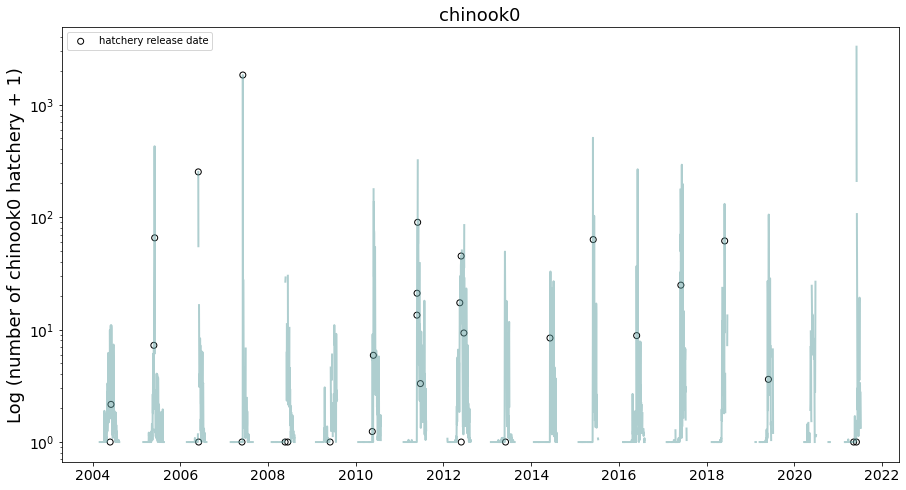

In [17]:
chinook0_list = df_merged['Date'][~np.isnan(df_merged['total_chinook0'])]
na_list = df_merged['chinook0_hatchery_perhour'][chinook0_list.index]+1
filled_list = na_list.fillna(1)
fig = plt.figure(figsize=(15,8))
plt.plot(df_merged['Date'], df_merged['chinook0_hatchery_perhour']+1, color="cadetblue", alpha = 0.5, linewidth = 2)
plt.yscale("log")
plt.scatter(chinook0_list, filled_list, facecolors='none', 
            color = 'black', label = 'hatchery release date')
plt.legend()
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.title("chinook0",fontsize = 18)
plt.ylabel("Log (number of chinook0 hatchery + 1)",fontsize = 18)

In [18]:
#find max hatchery between release and 50 days later
chinook0_hatchery_list = []
chinook0_wild_list = []
chinook0_prop_wild_list = []
fig = plt.figure(figsize=(15,10))
for i in chinook0_list.index:
    print(i)
    if len(df_merged['chinook0_hatchery_perhour']) < i+50:
        length_dataframe =  len(df_merged['chinook0_hatchery_perhour'])
    else:
        length_dataframe = i+50
    print(length_dataframe)
    if np.isnan(np.max(df_merged['chinook0_hatchery_perhour'][i:length_dataframe])):
        continue
    else:
        index = df_merged['chinook0_hatchery_perhour'][df_merged['chinook0_hatchery_perhour']==
                                                np.max(df_merged['chinook0_hatchery_perhour'][i:length_dataframe])].index[0]
    
    
    chinook0_hatchery_list.append(df_merged['chinook0_hatchery_perhour'][index])
    chinook0_wild_list.append(df_merged['chinook0_wild_perhour'][index])
    chinook0_prop_wild_list.append(df_merged['chinook0_wild_perhour'][index]/(
        df_merged['chinook0_hatchery_perhour'][index]+df_merged['chinook0_wild_perhour'][index]))

87
137
94
144
451
501
458
508
821
871
824
874
1185
1235
1192
1242
1544
1594
1566
1616
1919
1969
2270
2320
2279
2329
2642
2692
2643
2693
2648
2698
2671
2721
2999
3049
3010
3060
3011
3061
3033
3083
3380
3430
3750
3800
4110
4160
4472
4522
4840
4890
5205
5255
5569
5619
6279
6329
6302
6352


<ipython-input-18-7ced2d83c6e5>:22: RuntimeWarning: invalid value encountered in double_scalars
  chinook0_prop_wild_list.append(df_merged['chinook0_wild_perhour'][index]/(


<Figure size 1080x720 with 0 Axes>

In [20]:
chinook0_list = df_merged['Date'][~np.isnan(df_merged['total_chinook0'])]
# print(chinook0_list)

chinook0_hatchery_list = []
chinook0_hatchery_num_list = []
chinook0_wild_list = []
chinook0_wild_num_list = []
chinook0_prop_wild_list = []

for i in chinook0_list.index:
    if len(df_merged['chinook0_hatchery_perhour']) < i+10:
        length_dataframe =  len(df_merged['chinook0_hatchery_perhour'])
    else:
        length_dataframe = i+10
    if np.isnan(np.max(df_merged['chinook0_hatchery_perhour'][i:length_dataframe])):
        chinook0_hatchery_list.append(np.nan)
        chinook0_hatchery_num_list.append(np.nan)
        chinook0_wild_list.append(np.nan)
        chinook0_wild_num_list.append(np.nan)
        chinook0_prop_wild_list.append(np.nan)
    else:
        index = df_merged['chinook0_hatchery_perhour'][df_merged['chinook0_hatchery_perhour']==
                                                np.max(df_merged['chinook0_hatchery_perhour'][i:length_dataframe])].index[0]
        chinook0_hatchery_list.append(df_merged['chinook0_hatchery_perhour'][index])
        chinook0_hatchery_num_list.append(df_merged['chinook0_hatchery_num'][index])
        chinook0_wild_list.append(df_merged['chinook0_wild_perhour'][index])
        chinook0_wild_num_list.append(df_merged['chinook0_wild_num'][index])
        chinook0_prop_wild_list.append(df_merged['chinook0_wild_perhour'][index]/(
            df_merged['chinook0_hatchery_perhour'][index]+df_merged['chinook0_wild_perhour'][index]))
# print(chinook0_prop_wild_list)

data_unmarked_chinook_puyallup = np.array([chinook0_list, 
                                  df_merged['untagged_unclipped_chinook0'][chinook0_list.index],
                                  chinook0_wild_num_list,
                                  chinook0_hatchery_num_list,
                                  df_merged['prop_unmarked_chinook0'][chinook0_list.index],
                                  chinook0_prop_wild_list])

data_unmarked_puyallup_chinook = pd.DataFrame(np.transpose(data_unmarked_chinook_puyallup), columns = ['chinook0_puyallup_Date',
                                                                               'chinook0_puyallup_unmarked', 
                                                                               'chinook0_puyallup_wild_num',
                                                                                'chinook0_puyallup_hatchery_num',
                                                                               'chinook0_puyallup_unmarked_prop', 
                                                                               'chinook0_puyallup_wild_prop'])
# data_unmarked_puyallup_chinook['chinook0_puyallup_year'] = data_unmarked_puyallup_chinook['chinook0_puyallup_Date'].dt.year

data_unmarked_puyallup_chinook

<ipython-input-20-1c52bbc0d9b2>:28: RuntimeWarning: invalid value encountered in double_scalars
  chinook0_prop_wild_list.append(df_merged['chinook0_wild_perhour'][index]/(


,chinook0_puyallup_Date,chinook0_puyallup_unmarked,chinook0_puyallup_wild_num,chinook0_puyallup_hatchery_num,chinook0_puyallup_unmarked_prop,chinook0_puyallup_wild_prop
0,2004-05-26,18071,NaN,NaN,0.0109743,0.157706
1,2004-06-02,546,NaN,NaN,0.0052907,0.0840336
2,2005-05-25,0,28,9258,0,0.00301529
3,2005-06-01,0,28,1401,0,0.0195941
4,2006-05-30,10698,32,5404,0.00761623,0.00588668
5,2006-06-02,2266,28,341,0.00890076,0.0758808
6,2007-05-29,2012,31,19247,0.0242623,0.00160805
7,2007-06-05,8465,31,19247,0.00470859,0.00160805
8,2008-05-22,0,68,660,0,0.0934066
9,2008-06-13,6408,11,502,0.00377942,0.0214425


In [24]:
coho1_list = df_merged['Date'][~np.isnan(df_merged['total_coho1'])]
# print(coho1_list)

coho1_hatchery_list = []
coho1_hatchery_num_list = []
coho1_wild_list = []
coho1_wild_num_list = []
coho1_prop_wild_list = []

for i in coho1_list.index:
    if len(df_merged['coho1_hatchery_perhour']) < i+10:
        length_dataframe =  len(df_merged['coho1_hatchery_perhour'])
    else:
        length_dataframe = i+10
    if np.isnan(np.max(df_merged['coho1_hatchery_perhour'][i:length_dataframe])):
        coho1_hatchery_list.append(np.nan)
        coho1_hatchery_num_list.append(np.nan)
        coho1_wild_list.append(np.nan)
        coho1_wild_num_list.append(np.nan)
        coho1_prop_wild_list.append(np.nan)
    else:
        index = df_merged['coho1_hatchery_perhour'][df_merged['coho1_hatchery_perhour']==
                                                np.max(df_merged['coho1_hatchery_perhour'][i:length_dataframe])].index[0]
        coho1_hatchery_list.append(df_merged['coho1_hatchery_perhour'][index])
        coho1_hatchery_num_list.append(df_merged['coho1_hatchery_num'][index])
        coho1_wild_list.append(df_merged['coho1_wild_perhour'][index])
        coho1_wild_num_list.append(df_merged['coho1_wild_num'][index])
        coho1_prop_wild_list.append(df_merged['coho1_wild_perhour'][index]/(
            df_merged['coho1_hatchery_perhour'][index]+df_merged['coho1_wild_perhour'][index]))
# print(coho1_prop_wild_list)

data_unmarked_coho_puyallup = np.array([coho1_list, 
                                  df_merged['untagged_unclipped_coho1'][coho1_list.index],
                                  coho1_wild_num_list,
                                  coho1_hatchery_num_list,
                                  df_merged['prop_unmarked_coho1'][coho1_list.index],
                                  coho1_prop_wild_list])

data_unmarked_puyallup_coho = pd.DataFrame(np.transpose(data_unmarked_coho_puyallup), columns = ['coho1_puyallup_Date',
                                                                               'coho1_puyallup_unmarked', 
                                                                               'coho1_puyallup_wild_num',
                                                                                'coho1_puyallup_hatchery_num',
                                                                               'coho1_puyallup_unmarked_prop', 
                                                                               'coho1_puyallup_wild_prop'])
# data_unmarked_puyallup_coho['coho1_puyallup_year'] = data_unmarked_puyallup_coho['coho1_puyallup_Date'].dt.year

data_unmarked_puyallup_coho

<ipython-input-24-7e9857d98bd8>:28: RuntimeWarning: invalid value encountered in double_scalars
  coho1_prop_wild_list.append(df_merged['coho1_wild_perhour'][index]/(


,coho1_puyallup_Date,coho1_puyallup_unmarked,coho1_puyallup_wild_num,coho1_puyallup_hatchery_num,coho1_puyallup_unmarked_prop,coho1_puyallup_wild_prop
0,2004-04-15,11158,1,285,0.013158,0.0034965
1,2004-04-26,1132,12,381,0.00639548,0.0305344
2,2005-03-14,0,0,0,0,NaN
3,2005-04-20,495,36,2261,0.000540984,0.0156726
4,2006-04-18,10366,6,1057,0.0117929,0.0056444
5,2006-05-30,1,5,111,9.75106e-06,0.0431034
6,2007-04-30,3160,0,87,0.00470028,0
7,2007-05-08,0,2,17,0,0.105263
8,2008-04-25,5476,6,8449,0.00685271,0.000709639
9,2009-01-09,2496,NaN,NaN,0.0049416,NaN


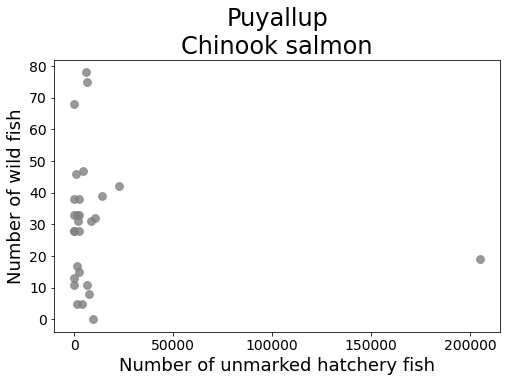

In [22]:
fig1 = plt.figure(figsize=(8,5))
plt.scatter(data_unmarked_puyallup_chinook['chinook0_puyallup_unmarked'],
           data_unmarked_puyallup_chinook['chinook0_puyallup_wild_num'], alpha = 0.8, color = 'gray', s = 60)
plt.xlabel('Number of unmarked hatchery fish', fontsize = 18)
plt.ylabel('Number of wild fish', fontsize = 18)
plt.title('Puyallup\nChinook salmon', fontsize  = 24)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.savefig(output_string + 'chinook0_unmarked_hatchery_new.jpeg')

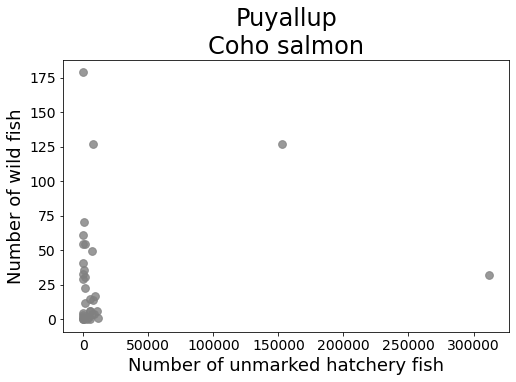

In [25]:
fig1 = plt.figure(figsize=(8,5))
plt.scatter(data_unmarked_puyallup_coho['coho1_puyallup_unmarked'],
           data_unmarked_puyallup_coho['coho1_puyallup_wild_num'], alpha = 0.8, color = 'gray', s = 60)
plt.xlabel('Number of unmarked hatchery fish', fontsize = 18)
plt.ylabel('Number of wild fish', fontsize = 18)
plt.title('Puyallup\nCoho salmon', fontsize  = 24)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.savefig(output_string + 'coho1_unmarked_hatchery_new.jpeg')

In [26]:
data_unmarked_puyallup_chinook.to_csv(output_string+'unmarked_hatchery_chinook_corrected_new.csv')
data_unmarked_puyallup_coho.to_csv(output_string+'unmarked_hatchery_coho_corrected_new.csv')